# Load data 



In [1]:
import pandas as pd
import numpy as np
import pylab
%matplotlib inline

import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)

df = pd.read_csv("../data/20180508-wikia_stats_users.csv")
df.drop_duplicates(subset=['url'], inplace=True)
df.head()

,domain,hub,id,lang,language,name,stats.activeUsers,stats.admins,stats.articles,stats.discussions,...,url,wam_score,stats.nonarticles,users_1,users_5,users_10,users_20,users_50,users_100,bots
0,0ad.wikia.com,Games,194794,en,en,0 A.D. Wiki,1,3,101,NaN,...,http://0ad.wikia.com/,2.4465,824,38,20,14,9,7,5,8
1,0hourmysticknights.wikia.com,Games,1459872,en,en,0 Hour: Mystic Knights Wikia,0,1,22,0.0,...,http://0hourmysticknights.wikia.com/,0.0000,139,7,6,3,1,1,1,4
2,0-xxii.wikia.com,Games,685186,en,en,0-XXII Wiki,0,1,34,1.0,...,http://0-xxii.wikia.com/,0.0000,262,5,3,3,2,2,1,3
3,00fanon.wikia.com,TV,350933,en,en,00 Fanon Wiki,1,1,93,1.0,...,http://00fanon.wikia.com/,0.0000,257,5,2,1,1,1,1,3
4,0002oifos.wikia.com,Games,678685,en,en,0002oifos Wiki,0,1,6,0.0,...,http://0002oifos.wikia.com/,0.0000,263,3,1,1,1,1,1,2


In [3]:
def describeMetric(df, metric):
    print(df[metric].describe())
    print("90%: {}".format(df[metric].quantile(0.9)))
    print("95%: {}".format(df[metric].quantile(0.95)))
    print("99%: {}".format(df[metric].quantile(0.99)))

# Edit stats

In [4]:
describeMetric(df, 'stats.edits')

count    3.922150e+05
mean     1.928624e+03
std      5.373045e+04
min      0.000000e+00
25%      1.210000e+02
50%      2.340000e+02
75%      3.500000e+02
max      2.150603e+07
Name: stats.edits, dtype: float64
90%: 931.0
95%: 2263.0
99%: 18400.019999999902


# Content stats

- `stats.pages` refers to all pages in the wiki, including articles, talk pages, redirects, etc.
- `stats.articles` refers to the number of content pages in the wiki.

## Pages


In [5]:
describeMetric(df, 'stats.pages')

count    3.922150e+05
mean     7.617775e+02
std      1.713391e+04
min      1.000000e+00
25%      1.030000e+02
50%      1.870000e+02
75%      2.480000e+02
max      6.174325e+06
Name: stats.pages, dtype: float64
90%: 437.0
95%: 906.0
99%: 6627.719999999972


## Articles

In [6]:
describeMetric(df, 'stats.articles')

count    3.922150e+05
mean     8.787311e+01
std      4.485363e+03
min      0.000000e+00
25%      5.000000e+00
50%      8.000000e+00
75%      2.000000e+01
max      2.216232e+06
Name: stats.articles, dtype: float64
90%: 64.0
95%: 150.0
99%: 899.0


## Edits per page

In [7]:
df['editsperpage'] = df['stats.edits'] / df['stats.pages']

In [8]:
describeMetric(df, 'editsperpage')

count    392215.000000
mean          1.593495
std           2.226864
min           0.000000
25%           1.071429
50%           1.188889
75%           1.549133
max         356.600000
Name: editsperpage, dtype: float64
90%: 2.297176265877851
95%: 3.1253166378265056
99%: 6.9622307141151145


# Distribution by language

In [9]:
groupByLanguage = df.groupby(by="lang")
byLanguage = groupByLanguage.id.count()
byLanguage.sort_values(ascending=False, inplace=True)
byLanguage

lang
en         276189
es          36383
ru          17545
de          13681
pl           9484
fr           8433
pt-br        7473
it           4014
zh           2546
nl           2187
pt           1746
ko           1349
ja           1311
fi           1103
tr            931
vi            768
sv            654
hu            645
cs            596
id            566
th            363
uk            347
he            331
ro            312
da            307
el            301
no            295
zh-tw         247
ca            235
ar            203
            ...  
ia              1
kk              1
ig              1
inh             1
io              1
qu              1
prg             1
pie             1
pag             1
nso             1
new             1
scn             1
fr-ca           1
ts              1
to              1
tn              1
nb              1
tg-cyrl         1
kw              1
su              1
frp             1
kr              1
min             1
st              1
gag  

In [10]:
def langOther(x):
    if x in byLanguage.index[:8].values:
        return x
    else:
        return 'other'
    
byLanguage.index[:8]
df['language'] = df['lang']
df['language'] = df['language'].apply(langOther)

In [11]:
byReducedLanguage = df.groupby(by="language").id.count()
byReducedLanguage.sort_values(ascending=False, inplace=True)
byReducedLanguage

language
en       276189
es        36383
other     19013
ru        17545
de        13681
pl         9484
fr         8433
pt-br      7473
it         4014
Name: id, dtype: int64

In [12]:
values = byReducedLanguage.values
values = 100*(values/values.sum())


data = [go.Bar(
            x=values,
            y=byReducedLanguage.index.values,
            orientation = 'h'
)]

annotations = [dict(
            x=x+8,
            y=y,
            xref='x',
            yref='y',
            text='{0:.2f}%'.format(x),
            showarrow=False
        ) for (x,y) in zip(values, list(range(0,len(values))))]

layout = go.Layout(
    xaxis=dict(
        range=[0,101],
        domain=[0,0.5],
        tickfont=dict(
            size=14,
        ),
        #showline=True
    ),
    yaxis=dict(
        tickfont=dict(
            size=14,
        ),
        ticksuffix=" "
    ),
    annotations = annotations
);


iplot(go.Figure(data= data, layout=layout), filename="byLanguage")

# Distribution by hub category

Hub categories are defined by Wikia

In [13]:
groupByHub = df.groupby(by="hub")
byHub = groupByHub.id.count()
byHub.sort_values(ascending=False, inplace=True)
byHub

hub
Games        139795
Lifestyle    111880
TV            54802
Books         28139
Comics        18001
Movies        17280
Music         11567
Other         10751
Name: id, dtype: int64

In [14]:
values = byHub.values
values = 100*(values/values.sum())


data = [go.Bar(
            x=values,
            y=byHub.index.values,
            orientation = 'h'
)]

annotations = [dict(
            x=x+8,
            y=y,
            xref='x',
            yref='y',
            text='{0:.2f}%'.format(x),
            showarrow=False
        ) for (x,y) in zip(values, list(range(0,len(values))))]

layout = go.Layout(
    xaxis=dict(
        range=[0,101],
        domain=[0,0.5],
        tickfont=dict(
            size=14,
        ),
        #showline=True
    ),
    yaxis=dict(
        tickfont=dict(
            size=14,
        ),
        ticksuffix=" "
    ),
    annotations = annotations
);


iplot(go.Figure(data= data, layout=layout), filename="byHub")

# Analysis of Active and Inactive wikis

**Active wikis** are the ones with at least 1 user (`user_1`) and at least 1 active user in the previous 30 days (`stats.activeUsers`)


In [15]:
threshold = 1
totalWikis = len(df) 
deadWikis = df[(df['stats.activeUsers']<threshold)|(df['users_1']==0)]
print ("Dead Wikis: {} ({:05.2f}%)".format(len(deadWikis), 100*len(deadWikis)/totalWikis))

Dead Wikis: 275108 (70.14%)


In [16]:
aliveWikis = df[(df['stats.activeUsers']>=threshold)&(df['users_1']>0)]
print ("Alive Wikis: {} ({:05.2f}%)".format(len(aliveWikis), 100*len(aliveWikis)/totalWikis))
print("With less than 5 articles: {}".format(len(aliveWikis[aliveWikis['stats.articles']<5])))
print("With less than 24 pages: {}".format(len(aliveWikis[aliveWikis['stats.pages']<24])))
print("With less than 4 users: {}".format(len(aliveWikis[aliveWikis['users_1']<4])))

Alive Wikis: 117107 (29.86%)
With less than 5 articles: 24558
With less than 24 pages: 605
With less than 4 users: 9538


## Scatterplot of the number of users over the number of articles, distinguishing between active wikis (green) and inactive wikis (black)

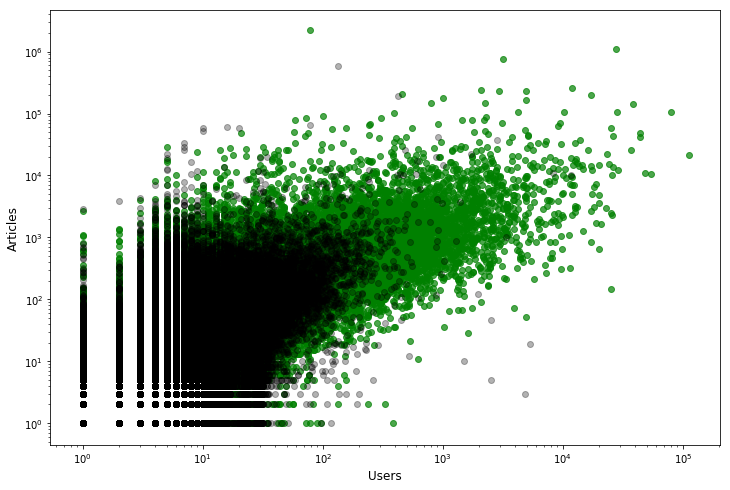

In [18]:
fig = pylab.figure(figsize=(12,8))
ax = pylab.gca()
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('Users', {'size': 'large'})
ax.set_ylabel('Articles', {'size': 'large'})
ax.scatter(aliveWikis['users_1'].values,aliveWikis['stats.articles'].values, c='g',alpha=0.7)
ax.scatter(deadWikis['users_1'].values,deadWikis['stats.articles'].values, c='black', alpha=0.3)

## Scatterplot of the number of users over the number of edits, distinguishing between active wikis (green) and inactive wikis (black)


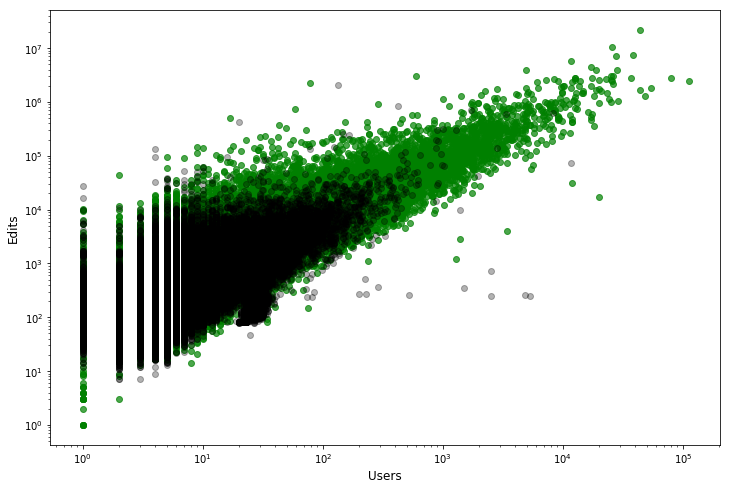

In [19]:
fig = pylab.figure(figsize=(12,8))
ax = pylab.gca()
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('Users', {'size': 'large'})
ax.set_ylabel('Edits', {'size': 'large'})
ax.scatter(aliveWikis['users_1'].values,aliveWikis['stats.edits'].values, c='g',alpha=0.7)
ax.scatter(deadWikis['users_1'].values,deadWikis['stats.edits'].values, c='black', alpha=0.3)

## Scatterplot of the number of articles over the number of edits, distinguishing between active wikis (green) and inactive wikis (black)

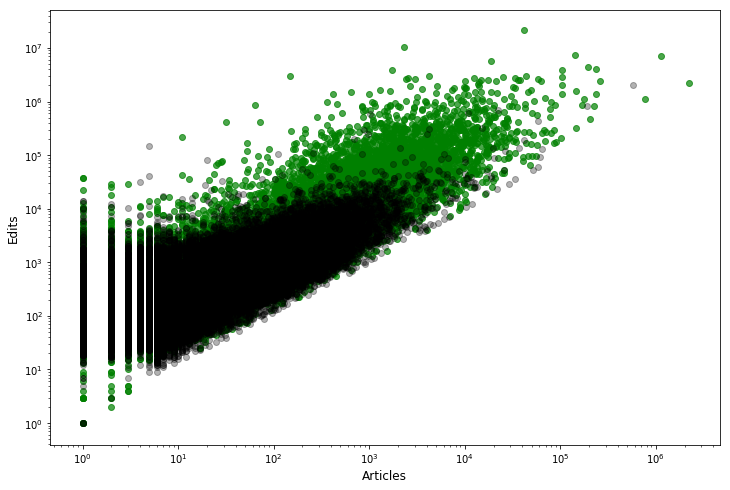

In [21]:
fig = pylab.figure(figsize=(12,8))
ax = pylab.gca()
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('Articles', {'size': 'large'})
ax.set_ylabel('Edits', {'size': 'large'})
ax.scatter(aliveWikis['stats.articles'].values,aliveWikis['stats.edits'].values, c='g',alpha=0.7)
ax.scatter(deadWikis['stats.articles'].values,deadWikis['stats.edits'].values, c='black', alpha=0.3)

## Cummulative of wikis having at least U users

In [28]:
histAlive, binsAlive = np.histogram(aliveWikis[['users_1']],bins=int(aliveWikis[['users_1']].max()))
yAlive = np.cumsum(histAlive[::-1])[::-1]

histDead, binsDead = np.histogram(deadWikis[['users_1']],bins=int(deadWikis[['users_1']].max()))
yDead = np.cumsum(histDead[::-1])[::-1]

In [25]:
data = [
    go.Scattergl(
        x=binsAlive[0:len(binsAlive)-1],
        y=yAlive,     
        mode='markers',
        name="Active wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='green',
            size=8
        )
    ),
    go.Scattergl(
        x=binsDead[0:len(binsDead)-1],
        y=yDead, 
        mode='markers',
        name="Inactive wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='black',
            size=8
        )
    )
]

layout = go.Layout(
    xaxis=dict(
        type='log',
        autorange=True,
        exponentformat="power",
        title="At least U users"
    ),
    yaxis=dict(
        type='log',
        autorange=True,
        exponentformat="power",
        title="Number of wikis"
    ),
    legend=dict(
        x=0.7,
        y=0.9
    )
)

iplot(go.Figure(data= data, layout=layout))

## Cummulative of wikis having at least E edits


In [26]:
histAlive, binsAlive = np.histogram(aliveWikis[['stats.edits']],bins= 100000)#int(aliveWikis[['stats.edits']].max()))
yAlive = np.cumsum(histAlive[::-1])[::-1]

histDead, binsDead = np.histogram(deadWikis[['stats.edits']],bins=100000)#int(deadWikis[['stats.edits']].max()))
yDead = np.cumsum(histDead[::-1])[::-1]

In [27]:
data = [
    go.Scattergl(
        x=binsAlive[0:len(binsAlive)-1],
        y=yAlive,     
        mode='markers',
        name="Active wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='green',
            size=8
        )
    ),
    go.Scattergl(
        x=binsDead[0:len(binsDead)-1],
        y=yDead, 
        mode='markers',
        name="Inactive wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='black',
            size=8
        )
    )
]

layout = go.Layout(
    xaxis=dict(
        type='log',
        autorange=True,
        exponentformat="power",
        title="At least E edits"
    ),
    yaxis=dict(
        type='log',
        autorange=True,
        exponentformat="power",
        title="Number of wikis"
    ),
    legend=dict(
        x=0.7,
        y=0.9
    )
)

iplot(go.Figure(data= data, layout=layout))

## Cummulative of wikis having at least P articles

In [29]:
histAlive, binsAlive = np.histogram(aliveWikis[['stats.articles']],bins= 100000)#int(aliveWikis[['stats.articles']].max()))
yAlive = np.cumsum(histAlive[::-1])[::-1]

histDead, binsDead = np.histogram(deadWikis[['stats.articles']],bins=100000)#int(deadWikis[['stats.articles']].max()))
yDead = np.cumsum(histDead[::-1])[::-1]

In [30]:
data = [
    go.Scattergl(
        x=binsAlive[0:len(binsAlive)-1],
        y=yAlive,     
        mode='markers',
        name="Active wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='green',
            size=8
        )
    ),
    go.Scattergl(
        x=binsDead[0:len(binsDead)-1],
        y=yDead, 
        mode='markers',
        name="Inactive wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='black',
            size=8
        )
    )
]

layout = go.Layout(
    xaxis=dict(
        type='log',
        autorange=True,
        exponentformat="power",
        title="At least P articles"
    ),
    yaxis=dict(
        type='log',
        autorange=True,
        exponentformat="power",
        title="Number of wikis"
    ),
    legend=dict(
        x=0.7,
        y=0.9
    )
)

iplot(go.Figure(data= data, layout=layout), filename="edits-cumsum")